# Notebook de recherche de modèles pré-entrainés pour la detection audio  

Ce notebook est incomplet, tous les modèles présentés ne sont pas testés

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [ ]:
MetaDataPath = "/content/gdrive/MyDrive/Projet_Multimedia/download/endroit/"
VideoPath = "/content/gdrive/MyDrive/Projet_Multimedia/videos/"
AudioPath = "/content/gdrive/MyDrive/Projet_Multimedia/download/Audio/"

In [ ]:
from os import listdir
from os.path import isfile, join
AudioFiles = [f for f in listdir(AudioPath) if isfile(join(AudioPath, f))]

In [ ]:
len(AudioFiles)

2080

# Plusieurs Modèles Pré Entrainnés pour la detection d'audio

## 1. VGGish

- VGGish is a pre-trained deep learning model for audio classification developed by Google.  
- It's trained on a large dataset and can classify audio into 128 categories.  
- You can find the pre-trained model and usage examples in the [VGGish repository](https://github.com/tensorflow/models/tree/master/research/audioset/vggish).  


### test 1

In [ ]:
!pip install resampy

In [ ]:
!git clone https://github.com/tensorflow/models.git /content/VGGish_models/

Cloning into '/content/VGGish_models'...
remote: Enumerating objects: 88115, done.
remote: Counting objects: 100% (1823/1823), done.
remote: Compressing objects: 100% (765/765), done.
remote: Total 88115 (delta 1188), reused 1625 (delta 1040), pack-reused 86292
Receiving objects: 100% (88115/88115), 603.02 MiB | 26.80 MiB/s, done.
Resolving deltas: 100% (63099/63099), done.


In [ ]:
VGGishPath = "/content/VGGish_models/research/audioset/vggish/"

In [ ]:
import numpy
import resampy
import tensorflow
import tf_slim
import six
import soundfile

!sudo python -m pip install --upgrade pip wheel

# Install all dependences.
!sudo pip install -r /content/VGGish_models/research/audioset/vggish/requirements.txt

# Clone TensorFlow models repo into a 'models' directory.
!git clone https://github.com/tensorflow/models.git
!cd models/research/audioset/vggish
# Download data files into same directory as code.
!curl -O https://storage.googleapis.com/audioset/vggish_model.ckpt
!curl -O https://storage.googleapis.com/audioset/vggish_pca_params.npz

# Installation ready, let's test it.
!python /content/VGGish_models/research/audioset/vggish/vggish_smoke_test.py

fatal: destination path 'models' already exists and is not an empty directory.
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  277M  100  277M    0     0   128M      0  0:00:02  0:00:02 --:--:--  128M
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 73020  100 73020    0     0   393k      0 --:--:-- --:--:-- --:--:--  393k
2023-10-25 11:59:50.604491: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-10-25 11:59:50.604562: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-10-25 11:59:50.6046

In [ ]:
AudioPath + AudioFiles[0]

'/content/gdrive/MyDrive/Projet_Multimedia/download/Audio/-V2-E9O2diAk.mp3'

In [ ]:
VGGishPath

'/content/VGGish_models/research/audioset/vggish/'

In [ ]:
!cp /content/VGGish_models/research/audioset/vggish/vggish_input.py /content/
!cp /content/VGGish_models/research/audioset/vggish/mel_features.py /content/
!cp /content/VGGish_models/research/audioset/vggish/vggish_params.py /content/

In [ ]:
import vggish_input

In [ ]:
from moviepy.editor import *
mp4_file = VideoPath + "video--6rP8FO_Vwc.mp4"
print(mp4_file)

videoclip = VideoFileClip(mp4_file)
audioclip = videoclip.audio

/content/gdrive/MyDrive/Projet_Multimedia/videos/video--6rP8FO_Vwc.mp4


In [ ]:
vggish_input.wavfile_to_examples(

In [ ]:
print(AudioPath + AudioFiles[0])
vggish_input.wavfile_to_examples(AudioPath + AudioFiles[0])

/content/gdrive/MyDrive/Projet_Multimedia/download/Audio/-V2-E9O2diAk.mp3


array([[[-4.60517019, -4.60517019, -4.60517019, ..., -4.60517019,
         -4.60517019, -4.60517019],
        [-4.60517019, -4.60517019, -4.60517019, ..., -4.60517019,
         -4.60517019, -4.60517019],
        [-4.60517019, -4.60517019, -4.60517019, ..., -4.60517019,
         -4.60517019, -4.60517019],
        ...,
        [-2.20551119, -2.21723548, -1.510423  , ..., -3.88123749,
         -3.67173244, -3.69779088],
        [-2.61153357, -1.55670807, -0.15644752, ..., -3.89775324,
         -3.9717234 , -3.83953363],
        [-1.96008569, -1.44616569, -1.11217344, ..., -3.90616067,
         -4.06090071, -4.04680013]],

       [[-2.06511459, -0.9937193 , -1.58249836, ..., -3.83599834,
         -4.23623344, -4.19248206],
        [-2.78101137, -1.85995327, -1.57018544, ..., -3.79233801,
         -4.082646  , -3.88818324],
        [-2.18062695, -2.3521267 , -1.25514585, ..., -3.67226672,
         -3.89539082, -3.65728494],
        ...,
        [-2.08720246, -1.90347479,  0.64875561, ..., -

### test 2

In [ ]:
import librosa
import numpy as np
import tensorflow as tf
import tensorflow_hub as hub
# Load the model.
model = hub.load('https://www.kaggle.com/models/google/vggish/frameworks/TensorFlow2/variations/vggish/versions/1')


result=[]
for i in AudioFiles[:1]:
    waveform , sr = librosa.load(AudioPath+i , sr=16000)
    if waveform.shape[0] % 16000 != 0:
        waveform = np.concatenate([waveform, np.zeros(16000)])
    inp = tf.constant( np.array([waveform]) , dtype='float32'  )
    class_scores = model( inp )[0].numpy()
    result.append( classes[  class_scores.argmax()])
result[:5]

TypeError: ignored

In [ ]:
file

'/content/gdrive/MyDrive/Projet_Multimedia/download/Audio/-V2-E9O2diAk.mp3'

In [ ]:
file = AudioPath + AudioFiles[0]
(fe,signal) = scipy.io.mp3file.read(file)
print(fe)
# Affichage du signal
plt.figure(1)
plt.plot(np.arange(len(signal))/fe,signal)
plt.xlabel('temps (s)')
plt.ylabel('Amplitude')
plt.title('Signal audio')
plt.grid(True)
plt.show()

AttributeError: ignored

### GOOD test 3

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
import numpy as np

# Load the model.
model = hub.load('https://www.kaggle.com/models/google/vggish/frameworks/TensorFlow2/variations/vggish/versions/1')
#model = hub.load('https://tfhub.dev/google/vggish/1')


In [ ]:
filename = AudioPath+AudioFiles[0]
print(filename)
waveform , sr = librosa.load(filename , sr=16000)
# Run the model, check the output.
embeddings = model(waveform)
embeddings.shape.assert_is_compatible_with([None, 128])

/content/gdrive/MyDrive/Projet_Multimedia/download/Audio/-V2-E9O2diAk.mp3


In [ ]:
from IPython.display import Audio
# lecture du fichier
Audio(data=waveform, rate=sr)

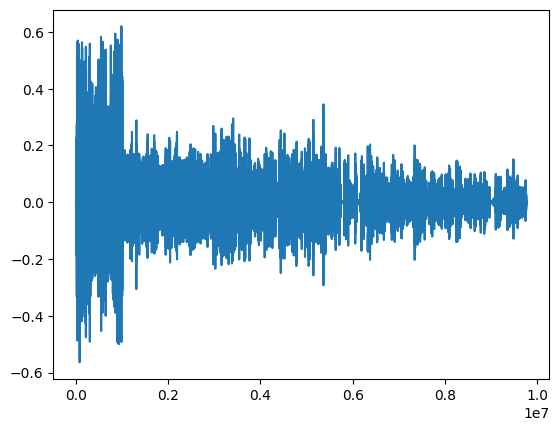

In [ ]:
plt.plot(waveform)

In [ ]:
alen(waveform)

9775360

In [ ]:
len(embeddings)

636

In [ ]:
610/0.96

635.4166666666667

#### Post-process the Embeddings

Post-processing the embeddings is an important step when using VGGish or similar models for audio feature extraction. This step typically involves aggregating the frame-level embeddings to obtain a fixed-length representation for the entire audio clip. There are various methods for post-processing the embeddings, and the choice depends on the specific task you're working on. Here are some common approaches:  

- Averaging: Calculate the mean or average of the frame-level embeddings along the time axis. This approach provides a simple representation that captures the overall characteristics of the audio.  

- Max-Pooling: Perform max-pooling over the frame-level embeddings. This method selects the maximum value for each dimension across the entire audio clip.   Max-pooling can capture the most prominent features in the audio.  

- Concatenation: Concatenate frame-level embeddings to create a longer sequence. This can be useful for sequence-based tasks, such as audio segmentation or classification.  

- PCA (Principal Component Analysis): Apply PCA to reduce the dimensionality of the embeddings while preserving the most important information. PCA can help in reducing computational complexity while retaining discriminative features.  

- LSTM (Long Short-Term Memory): If you're working on sequence-based tasks, you can feed the frame-level embeddings into an LSTM or a similar recurrent neural network to capture temporal dependencies. The final hidden state of the LSTM can be used as the audio representation.  

- Clustering: Cluster the frame-level embeddings to identify distinct patterns or segments in the audio. Assign each frame to the closest cluster, and use the cluster centers as representatives of different audio segments.  

- Attention Mechanisms: Use attention mechanisms to assign different weights to frame-level embeddings. The weighted sum of embeddings can serve as the audio representation, focusing on relevant portions of the audio.  

The choice of post-processing method depends on the nature of your audio analysis task. For instance, if you're performing audio classification, averaging or max-pooling may be suitable. If you're working on audio segmentation, LSTM-based approaches or clustering could be more appropriate.  

Experiment with different post-processing techniques to see which one works best for your specific application and dataset. It's common to try multiple methods and evaluate their performance to select the most effective one.  

In [ ]:
def averaging(embeddings):
  return np.mean(embeddings, axis=0)

def max_pooling(embeddings):
  return np.max(embeddings, axis=0)

- Data Preparation:

Organize your dataset, which should include labeled audio clips and their corresponding VGGish embeddings.
Split your dataset into training, validation, and test sets.  

- Classifier Selection:

Choose a classifier suitable for audio classification. Common choices include deep neural networks (e.g., convolutional neural networks, recurrent neural networks), support vector machines, or random forests.
Depending on the size of your dataset, consider using transfer learning with pre-trained models.  

- Model Architecture:

Define the architecture of your classifier. If using deep learning, define the layers, activation functions, and loss function.
You may choose to combine the VGGish embeddings with other audio features or use the embeddings alone as input to the classifier.  

- Training:

Train your classifier using the training dataset. Input the VGGish embeddings and the corresponding labels.
Monitor the training process and adjust hyperparameters as needed.  

- Validation:

Use the validation dataset to evaluate the classifier's performance. This helps you identify overfitting and fine-tune the model.  

- Testing:

Finally, evaluate the classifier on the test dataset to get an accurate measure of its performance.  

- Hyperparameter Tuning:

Experiment with different hyperparameters (e.g., learning rate, batch size) and architectural choices to optimize classifier performance.  

- Inference:

Once your classifier is trained and validated, you can use it for inference on new, unlabeled audio clips.
Pass the VGGish embeddings of an audio clip through the trained classifier to predict its category.  

### Test 4


In [ ]:
import tensorflow as tf
import numpy
import numpy as np
model = tf.saved_model.load( 'https://www.kaggle.com/code/gauravduttakiit/vggish-environmental-sound-classification-50-vggish/input' )

UnimplementedError: ignored

In [ ]:
classes = [  "airplane" ,  "breathing" ,  "brushing_teeth" ,  "can_opening" ,
           "car_horn" ,  "cat" ,  "chainsaw" ,  "chirping_birds" ,  "church_bells" ,
           "clapping" ,  "clock_alarm" ,  "clock_tick" ,  "coughing" ,  "cow" ,  "crackling_fire" ,
           "crickets" ,  "crow" ,  "crying_baby" ,  "dog" ,  "door_wood_creaks" ,  "door_wood_knock" ,
           "drinking_sipping" ,  "engine" ,  "fireworks" ,  "footsteps" ,  "frog" ,  "glass_breaking" ,
           "hand_saw" ,  "helicopter" ,  "hen" ,  "insects" ,  "keyboard_typing" ,  "laughing" ,
           "mouse_click" ,  "pig" ,  "pouring_water" ,  "rain" ,  "rooster" ,  "sea_waves" ,  "sheep" ,
           "siren" ,  "sneezing" ,  "snoring" ,  "thunderstorm" ,  "toilet_flush" ,  "train" ,
           "vacuum_cleaner" ,  "washing_machine" ,  "water_drops" ,  "wind" ,  ]

In [ ]:
len(classes)

50

### test 5

In [ ]:
cp /content/gdrive/MyDrive/Projet_Multimedia/Notebooks_TT/saved_model.pb /content/

In [ ]:
# TF for image segmentation model
import tensorflow
import numpy
import numpy as np
model = tensorflow.saved_model.load( '' )
classes = [  "airplane" ,  "breathing" ,  "brushing_teeth" ,  "can_opening" ,  "car_horn" ,  "cat" ,  "chainsaw" ,  "chirping_birds" ,  "church_bells" ,  "clapping" ,  "clock_alarm" ,  "clock_tick" ,  "coughing" ,  "cow" ,  "crackling_fire" ,  "crickets" ,  "crow" ,  "crying_baby" ,  "dog" ,  "door_wood_creaks" ,  "door_wood_knock" ,  "drinking_sipping" ,  "engine" ,  "fireworks" ,  "footsteps" ,  "frog" ,  "glass_breaking" ,  "hand_saw" ,  "helicopter" ,  "hen" ,  "insects" ,  "keyboard_typing" ,  "laughing" ,  "mouse_click" ,  "pig" ,  "pouring_water" ,  "rain" ,  "rooster" ,  "sea_waves" ,  "sheep" ,  "siren" ,  "sneezing" ,  "snoring" ,  "thunderstorm" ,  "toilet_flush" ,  "train" ,  "vacuum_cleaner" ,  "washing_machine" ,  "water_drops" ,  "wind" ,  ]
import librosa
waveform , sr = librosa.load('./sample.wav' , sr=16000)
if waveform.shape[0] % 16000 != 0:
	waveform = np.concatenate([waveform, np.zeros(16000)])
inp = tensorflow.constant( np.array([waveform]) , dtype='float32'  )
class_scores = model( inp )[0].numpy()
print("")
print("class_scores" , class_scores)
print("Class : " , classes[  class_scores.argmax()])

FileNotFoundError: ignored

## 2. YAMNet
- YAMNet is another pre-trained model by Google that's designed for audio event classification. It can classify audio into over 500 sound event categories.  
- The pre-trained model and usage examples are available in the [YAMNet repository](https://github.com/tensorflow/models/tree/master/research/audioset/yamnet).  


## 3. AudioSet Models
AudioSet is a large dataset of labeled sound events, and it includes several pre-trained models.  
You can explore these models and download them from the [AudioSet Model Zoo](https://research.google.com/ava/download.html).  

## 4. UrbanSound8K Models
UrbanSound8K is a dataset for urban sound classification. You can find pre-trained models trained on this dataset.  
One such example is the [UrbanSound8K pre-trained model in Keras]().

## 5. ESC-50 Models
ESC-50 is a dataset for environmental sound classification. You can find pre-trained models trained on this dataset.
For instance, you can explore this [ESC-50 pre-trained model in TensorFlow](https://github.com/karolpiczak/ESC-50#pre-trained-convolutional-neural-network-weights).